# EE490 - Final Project
## Coloring Images Using GAN Model
___

### Team Members:
1. Ahmed Alkhayal - 1945541
2. Abdulaziz Ebrahim - 1946282
3. Turki Al-Zahrani - 1935944
___

Acknowledgment: ML Eng. Moein Shariatnia for helper functions

### Importing Packages

In [1]:
# Helper packages
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb
Path.ls = lambda x: list(x.iterdir())

# AI packages
import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader

In [2]:
kaggle = False
# importing helper functions
if kaggle:
    from shutil import copyfile
    copyfile(src = "../input/helpers/helpers.py", dst = "../working/helpers.py")
    from helpers import *
else:
    from helpers import *

### Setting Up Data Paths

In [4]:
# Selecting training device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Setting seed for recreation
np.random.seed(123)

# dataset path
paths = glob.glob("../input/places3658k/places365/samples/*.jpg")

# choosing 3000 images randomly
paths_subset = np.random.choice(paths, 8300, replace=False)

# generating random indices for train/validation
rand_idxs = np.random.permutation(8300)
train_idxs = rand_idxs[:7000] # first 7000 images
val_idxs = rand_idxs[7000:] # last 1300 images

# selecting train/validation paths
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]

print(f"Training images:{len(train_paths)} | Validation images:{len(val_paths)}")

Training images:7000 | Validation images:1300


### Image Preview

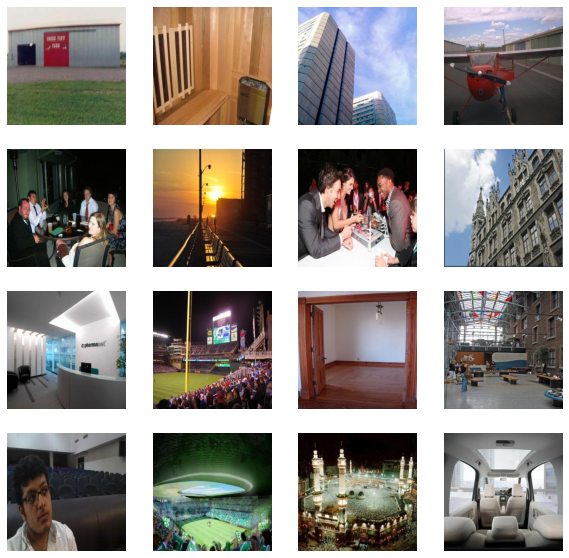

In [5]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

### Data Transformers & Generators

In [6]:
# Images size (SIZExSIZE)
SIZE = 256

# Data Generator Class
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        # Creating Data Transformers 
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE)),
                transforms.RandomHorizontalFlip() # Data augmentation
            ])
        elif split == 'val': # NO AUGMENTATION IN VALIDATION
            self.transforms = transforms.Resize((SIZE, SIZE))
        
        # object variables
        self.size = SIZE
        self.split = split
        self.paths = paths
    
    # Image list accessing method
    def __getitem__(self, idx):
        # read image
        img = Image.open(self.paths[idx]).convert("RGB")
        # transform image using object transformer [train/val]
        img = self.transforms(img)
        # converting image to L*a*b formate tensors
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32")
        img_lab = transforms.ToTensor()(img_lab)
        # rescaling images to range from [-1, 1]
        L = img_lab[[0], ...] / 50. - 1. 
        ab = img_lab[[1, 2], ...] / 110. 
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.paths)

# Dataloader function
def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs):
    """ Create dataloader of passed path

    Args:
        batch_size: generator batch size. Defaults to 16.
        n_workers: processor workers. Defaults to 4.
        pin_memory: move data to device/CUDA. Defaults to True.

    Returns:
        dataloader
    """
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

### Creating Dataloaders

In [7]:
# Create dataloaders
train_dl = make_dataloaders(batch_size=32, paths=train_paths, split='train')
val_dl = make_dataloaders(batch_size=32, paths=val_paths, split='val')

# Printing data shapes
dataiter = next(iter(train_dl))
Ls, abs_ = dataiter['L'], dataiter['ab']
print(f"L's Shape:{Ls.shape} | ab's Shape:{abs_.shape}")
print(f"Training batches:{len(train_dl)} | Validation batches:{len(val_dl)}")

/opt/conda/lib/python3.7/site-packages/torch/utils/data/dataloader.py:490: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


L's Shape:torch.Size([32, 1, 256, 256]) | ab's Shape:torch.Size([32, 2, 256, 256])
Training batches:219 | Validation batches:41


# Creating Model
___
### Model Architecture
![](Model%20Architecture.jpg)


### Generator Component

In [3]:
class Generator(nn.Module):
    def __init__(self, lr_G=2e-4, dropout=False):
        super(Generator, self).__init__()
        
        # Down sampling
        self.layer1_down = nn.Conv2d(1, 64, kernel_size=4, stride=2, padding=1, bias=False)  # 128x128
        self.layer2_down = self._make_layer_down(64, 128, 4, 2, 1, False)                    # 64x64
        self.layer3_down = self._make_layer_down(128, 256, 4, 2, 1, False)                   # 32x32
        self.layer4_down = self._make_layer_down(256, 512, 4, 2, 1, False)                   # 16x16
        self.layer5_down = self._make_layer_down(512, 512, 4, 2, 1, False)                   # 8x8
        self.layer6_down = self._make_layer_down(512, 512, 4, 2, 1, False)                   # 4x4
        self.layer7_down = self._make_layer_down(512, 512, 4, 2, 1, False)                   # 2x2
        
        # Connector
        self.layer8_middle = nn.Sequential(nn.LeakyReLU(0.2, True),
                                           nn.Conv2d(512, 512, 4, 2, 1, bias=False),         # 1x1
                                           nn.ReLU(True),
                                           nn.ConvTranspose2d(512, 512, 4, 2, 1, bias=False),# 2x2
                                           nn.BatchNorm2d(512))
        
        # Up sampling
        self.layer9_up = self._make_layer_up(1024, 512, 4, 2, 1, False, True)              # 4x4
        self.layer10_up = self._make_layer_up(1024, 512, 4, 2, 1, False, True)             # 8x8
        self.layer11_up = self._make_layer_up(1024, 512, 4, 2, 1, False, True)             # 16x16
        self.layer12_up = self._make_layer_up(1024, 256, 4, 2, 1, False, False)            # 32x32
        self.layer13_up = self._make_layer_up(512, 128, 4, 2, 1, False, False)             # 64x64
        self.layer14_up = self._make_layer_up(256, 64, 4, 2, 1, False, False)              # 128x128
        
        # Output layer
        self.layer15_up = nn.Sequential(nn.ReLU(True),
                                        nn.ConvTranspose2d(128, 2, 4, 2, 1),               # 256x256
                                        nn.Tanh())
        
        
    def _make_layer_down(self, in_c, out_c, kernel, stride, padding, bias=False):
        layers = []
        # Leaky ReLU
        layers.append(nn.LeakyReLU(0.2, True))
        # 2D convolution layer
        layers.append(nn.Conv2d(in_c, out_c, kernel_size=kernel, 
                                stride=stride, padding=padding, bias=bias))
        # Batch normalization
        layers.append(nn.BatchNorm2d(num_features=out_c))
        return nn.Sequential(*layers)
    
    def _make_layer_up(self, in_c, out_c, kernel, stride, padding, bias=False, dropout=False):
        layers = []
        # Leaky ReLU
        layers.append(nn.ReLU(True))
        # 2D convolution layer
        layers.append(nn.ConvTranspose2d(in_c, out_c, kernel_size=kernel, 
                                         stride=stride, padding=padding, bias=bias))
        # Batch normalization
        layers.append(nn.BatchNorm2d(num_features=out_c))
        if dropout: layers.append(nn.Dropout())
        return nn.Sequential(*layers)
    
    def forward(self, x):
        # store skip connections of U-NET architecture
        skip_connections = []
        
        # Down sampling
        x = self.layer1_down(x)
        skip_connections.append(x)
        x = self.layer2_down(x)
        skip_connections.append(x)
        x = self.layer3_down(x)
        skip_connections.append(x)
        x = self.layer4_down(x)
        skip_connections.append(x)
        x = self.layer5_down(x)
        skip_connections.append(x)
        x = self.layer6_down(x)
        skip_connections.append(x)
        x = self.layer7_down(x)
        skip_connections.append(x)
        
        # bottleneck
        x = self.layer8_middle(x)
        skip_connections = skip_connections[::-1]   # reversing list

        # Up sampling
        x = self.layer9_up(torch.cat([skip_connections.pop(0), x], dim=1))
        x = self.layer10_up(torch.cat([skip_connections.pop(0), x], dim=1))
        x = self.layer11_up(torch.cat([skip_connections.pop(0), x], dim=1))
        x = self.layer12_up(torch.cat([skip_connections.pop(0), x], dim=1))
        x = self.layer13_up(torch.cat([skip_connections.pop(0), x], dim=1))
        x = self.layer14_up(torch.cat([skip_connections.pop(0), x], dim=1))
        x = self.layer15_up(torch.cat([skip_connections.pop(0), x], dim=1))
        
        return x

In [4]:
class GANLoss(nn.Module):
    def __init__(self, real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        self.loss = nn.BCEWithLogitsLoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

### Discriminator Component

In [5]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.layer1 = self._make_layer(3, 64, 4, 2, 1, norm=False, act=True)    # 128x128
        self.layer2 = self._make_layer(64, 128, 4, 2, 1, norm=True, act=True)   # 64x64
        self.layer3 = self._make_layer(128, 256, 4, 2, 1, norm=True, act=True)  # 32x32
        self.layer4 = self._make_layer(256, 512, 4, 1, 1, norm=True, act=True)  # 16x16
        self.layer5 = self._make_layer(512, 1, 4, 1, 1, norm=False, act=False)  # 16X16
        
        
    def _make_layer(self, in_c, out_c, kernel,stride, padding, norm=True, act=True):
        layers = []
        # 2D convolution layer
        layers.append(nn.Conv2d(in_c, out_c, kernel, stride, padding, bias=not norm))
        # Batch normalization
        if norm: layers.append(nn.BatchNorm2d(out_c))
        # Activation function
        if act: layers.append(nn.LeakyReLU(0.2, True))
        return nn.Sequential(*layers)
    
    def forward(self, x):
        x = self.layer1(x)
        x = self.layer2(x)
        x = self.layer3(x)
        x = self.layer4(x)
        x = self.layer5(x)
        return x

# Combining Model Components

* ### Weight Initialization Function

In [6]:
def init_weights(net, gain=0.02):
    
    # weight initializing function
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            # initialize layer weights
            nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            # initialize layer bias
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
    
    # initialize model weights        
    net.apply(init_func)
    return net

def init_model(model, device):
    # Move model to device and initialize its weights
    model = model.to(device)
    model = init_weights(model)
    return model

* ### Model Class

In [7]:
class Model(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4, beta1=.5, beta2=0.999, lambda_L1=100.):
        super().__init__()
        
        # Selecting training device
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        # Creating Generator
        if net_G is None:
            self.net_G = init_model(Generator(dropout=True), self.device)
        else:
            self.net_G = net_G.to(self.device)
        
        # Creating Discriminator
        self.net_D = init_model(Discriminator(), self.device)
        
        # Initializing GAN loss functions (criterion)
        self.GANcriterion = GANLoss().to(self.device)
        self.L1criterion = nn.L1Loss()
        
        # Initializing optimizers for G an D
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
        
    def set_requires_grad(self, model, requires_grad=True):
        # Turn gradient on for parameters
        for p in model.parameters():
            p.requires_grad = requires_grad
            
    def setup_input(self, data):
        # Split input into correct layers
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        # Generate fake image
        self.fake_color = self.net_G(self.L)
        
    def backward_D(self):
        # Calculate loss for discriminator for optimizer step
        
        # Combine grayscale image "L" with generated colors "a, b"
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        
        # Get discriminator prediction and loss for fake image
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        
        # Get discriminator prediction and loss for real image
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        
        # Calculate Total Loss
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
        
    def backward_G(self):
        # Calculate loss for generator for optimizer step
        
        # Combine grayscale image "L" with generated colors "a, b"
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        
        # Get discriminator prediction and loss for fake image
        fake_preds = self.net_D(fake_image)
        
        # Calculate GAN/L1 loss
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        
        # Calculate Total Loss
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        # Update gradient based on loss values for G & D
        
        # Training Discriminator
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        # Training Generator
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

### Creating model

In [13]:
model = Model()
model

Model(
  (net_G): Generator(
    (layer1_down): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (layer2_down): Sequential(
      (0): LeakyReLU(negative_slope=0.2, inplace=True)
      (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (layer3_down): Sequential(
      (0): LeakyReLU(negative_slope=0.2, inplace=True)
      (1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (layer4_down): Sequential(
      (0): LeakyReLU(negative_slope=0.2, inplace=True)
      (1): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (layer5_down): Sequential(
      (0): LeakyReLU

# Training the Model

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 1/100
Iteration 215/219
loss_D_fake: 0.47074
loss_D_real: 0.48836
loss_D: 0.47955
loss_G_GAN: 1.54248
loss_G_L1: 9.04111
loss_G: 10.58359


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 37 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return func(*args, **kwargs)


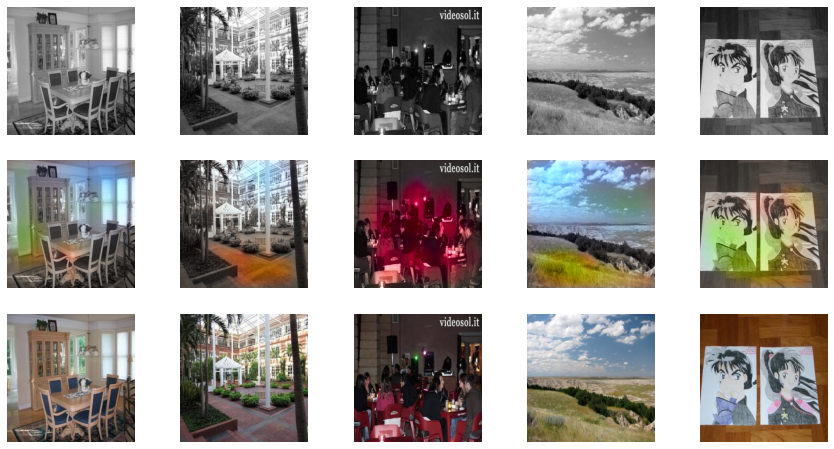

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 4/100
Iteration 215/219
loss_D_fake: 0.55493
loss_D_real: 0.58015
loss_D: 0.56754
loss_G_GAN: 1.22557
loss_G_L1: 9.75036
loss_G: 10.97593


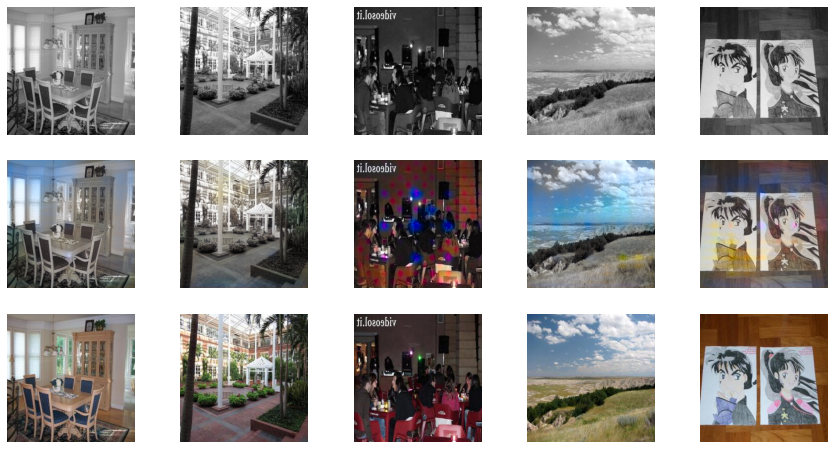

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 7/100
Iteration 215/219
loss_D_fake: 0.55080
loss_D_real: 0.58914
loss_D: 0.56997
loss_G_GAN: 1.18302
loss_G_L1: 9.64470
loss_G: 10.82773


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 385 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 60 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 62 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 52 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 44 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/ut

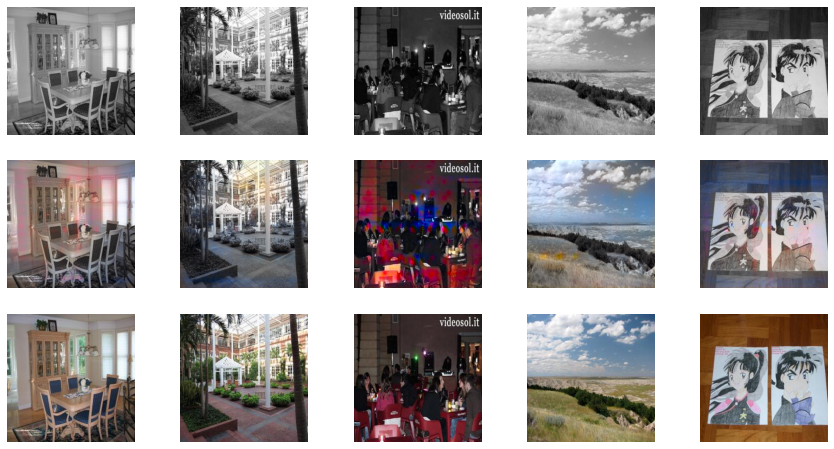

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 10/100
Iteration 215/219
loss_D_fake: 0.55787
loss_D_real: 0.60016
loss_D: 0.57901
loss_G_GAN: 1.13812
loss_G_L1: 9.45641
loss_G: 10.59452


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 93 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return func(*args, **kwargs)


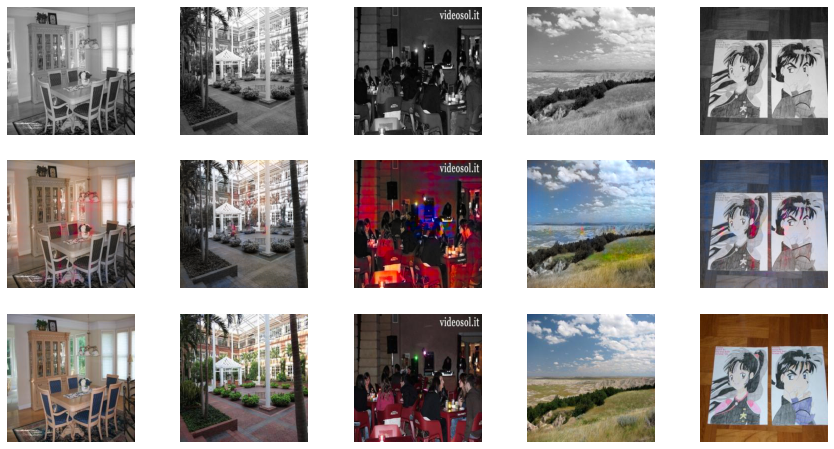

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 13/100
Iteration 215/219
loss_D_fake: 0.56154
loss_D_real: 0.60578
loss_D: 0.58366
loss_G_GAN: 1.12136
loss_G_L1: 9.24492
loss_G: 10.36629


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)


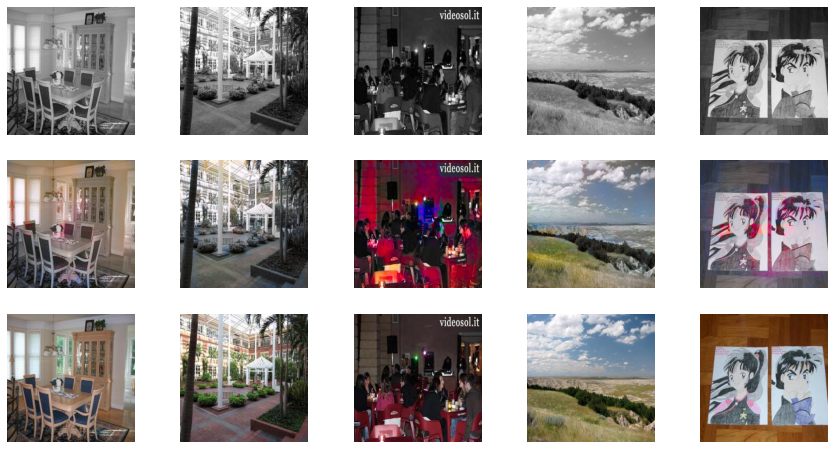

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 16/100
Iteration 215/219
loss_D_fake: 0.56843
loss_D_real: 0.61545
loss_D: 0.59194
loss_G_GAN: 1.08899
loss_G_L1: 8.94248
loss_G: 10.03147


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return func(*args, **kwargs)
/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return func(*args, **kwargs)


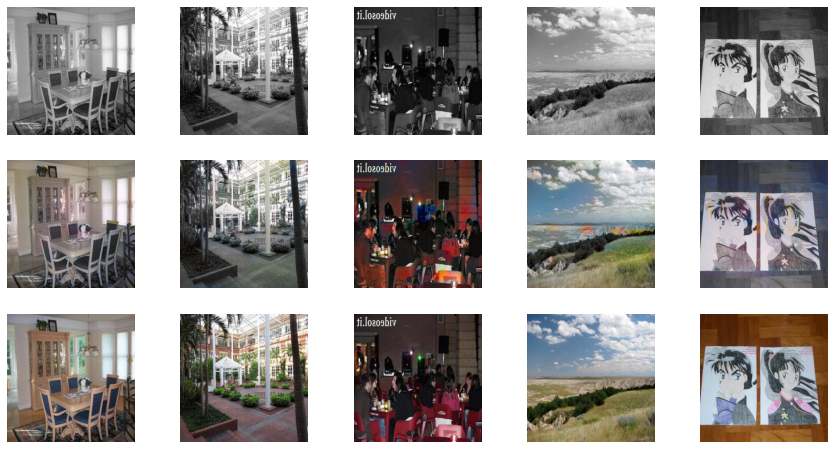

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 19/100
Iteration 215/219
loss_D_fake: 0.57506
loss_D_real: 0.61932
loss_D: 0.59719
loss_G_GAN: 1.06535
loss_G_L1: 8.58590
loss_G: 9.65126


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 111 pixels
  return func(*args, **kwargs)


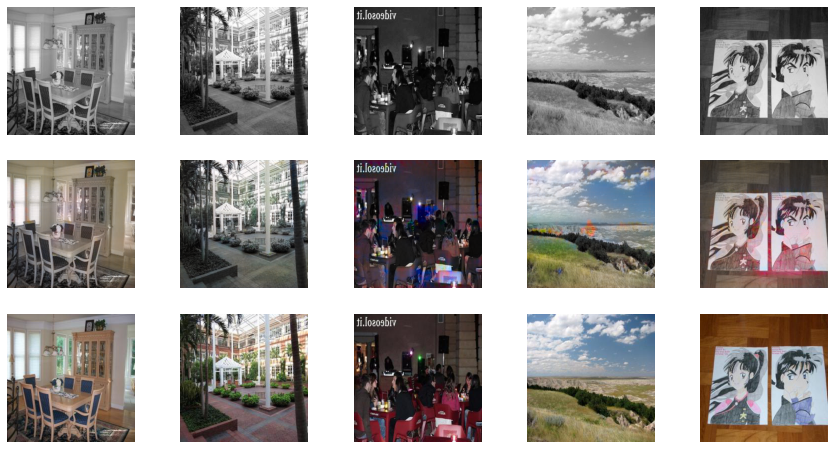

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 22/100
Iteration 215/219
loss_D_fake: 0.57564
loss_D_real: 0.61799
loss_D: 0.59682
loss_G_GAN: 1.04640
loss_G_L1: 8.25172
loss_G: 9.29812


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return func(*args, **kwargs)


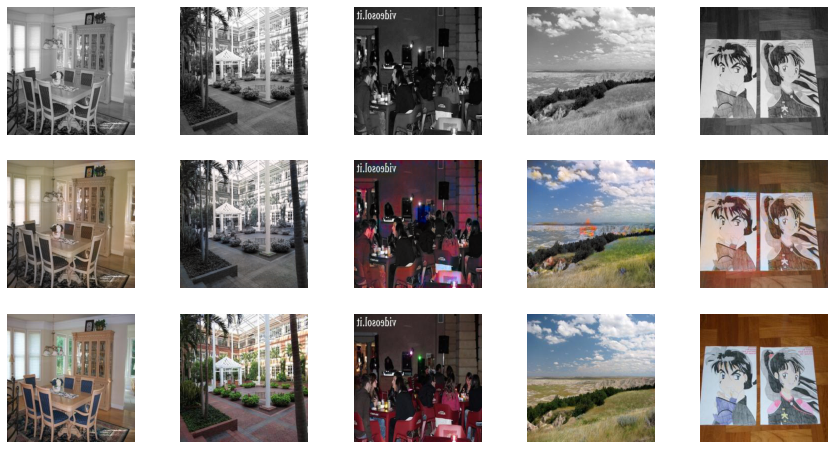

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 25/100
Iteration 215/219
loss_D_fake: 0.58104
loss_D_real: 0.61780
loss_D: 0.59942
loss_G_GAN: 1.03387
loss_G_L1: 7.86589
loss_G: 8.89975


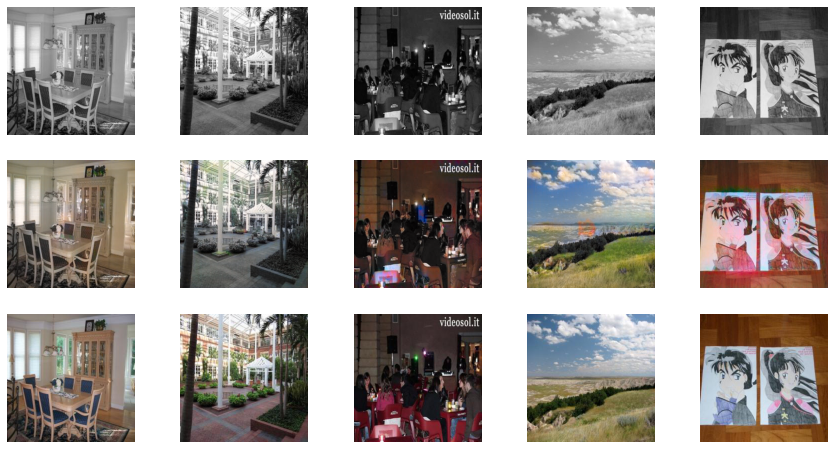

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 28/100
Iteration 215/219
loss_D_fake: 0.58291
loss_D_real: 0.61628
loss_D: 0.59960
loss_G_GAN: 1.02944
loss_G_L1: 7.53309
loss_G: 8.56253


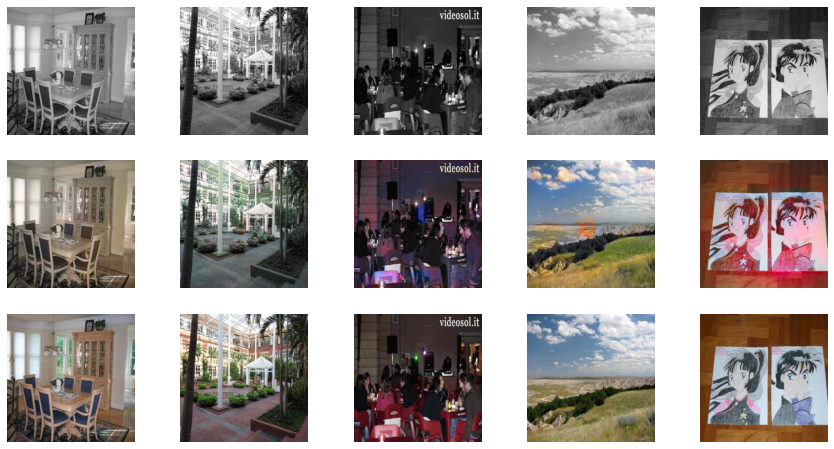

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 31/100
Iteration 215/219
loss_D_fake: 0.58583
loss_D_real: 0.61946
loss_D: 0.60264
loss_G_GAN: 1.02186
loss_G_L1: 7.20768
loss_G: 8.22954


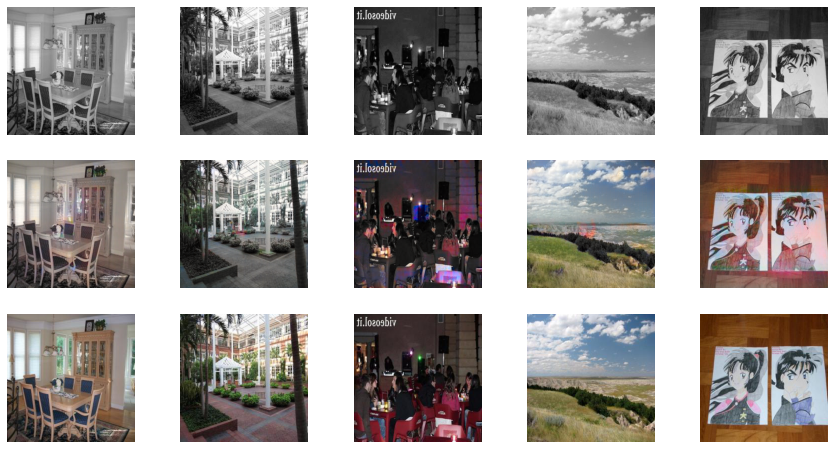

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 34/100
Iteration 215/219
loss_D_fake: 0.59170
loss_D_real: 0.61868
loss_D: 0.60519
loss_G_GAN: 1.01183
loss_G_L1: 6.92245
loss_G: 7.93428


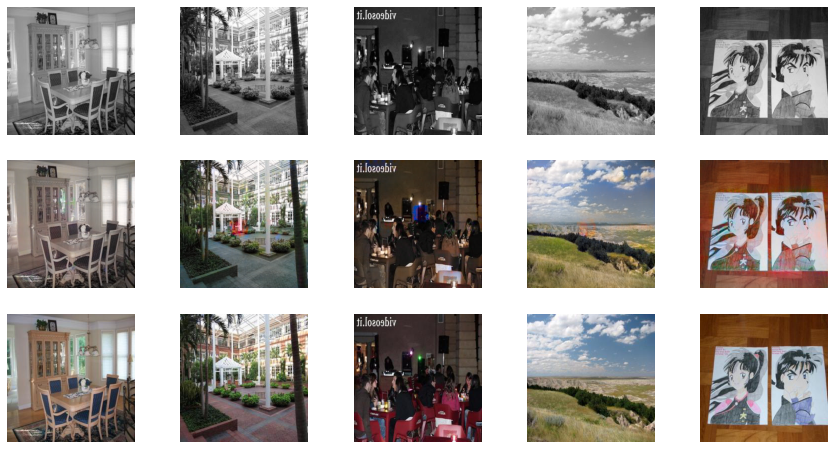

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 37/100
Iteration 215/219
loss_D_fake: 0.59288
loss_D_real: 0.61774
loss_D: 0.60531
loss_G_GAN: 1.01099
loss_G_L1: 6.66583
loss_G: 7.67682


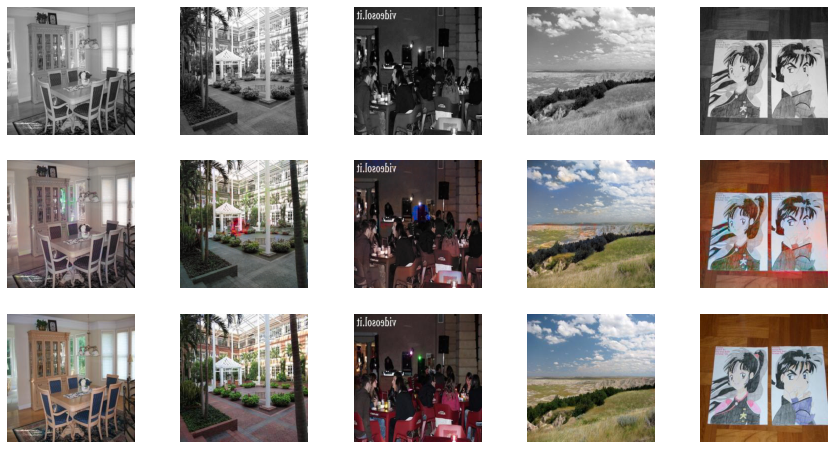

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 40/100
Iteration 215/219
loss_D_fake: 0.59346
loss_D_real: 0.61277
loss_D: 0.60311
loss_G_GAN: 1.01060
loss_G_L1: 6.45289
loss_G: 7.46348


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return func(*args, **kwargs)


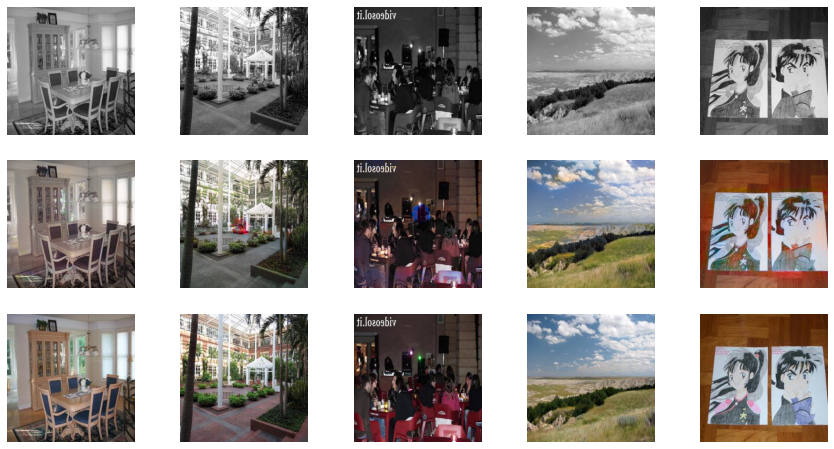

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 43/100
Iteration 215/219
loss_D_fake: 0.59457
loss_D_real: 0.61101
loss_D: 0.60279
loss_G_GAN: 1.01025
loss_G_L1: 6.25086
loss_G: 7.26111


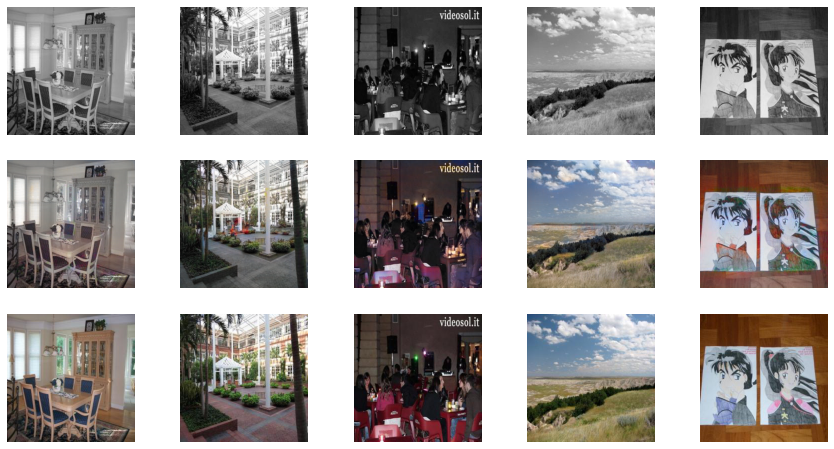

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 46/100
Iteration 215/219
loss_D_fake: 0.59693
loss_D_real: 0.60991
loss_D: 0.60342
loss_G_GAN: 1.01017
loss_G_L1: 6.08051
loss_G: 7.09068


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return func(*args, **kwargs)


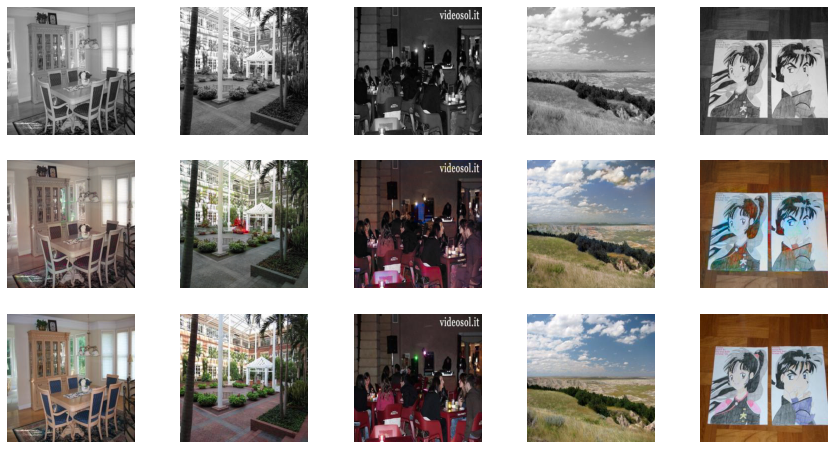

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 49/100
Iteration 215/219
loss_D_fake: 0.59793
loss_D_real: 0.61121
loss_D: 0.60457
loss_G_GAN: 1.00436
loss_G_L1: 5.93510
loss_G: 6.93946


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return func(*args, **kwargs)


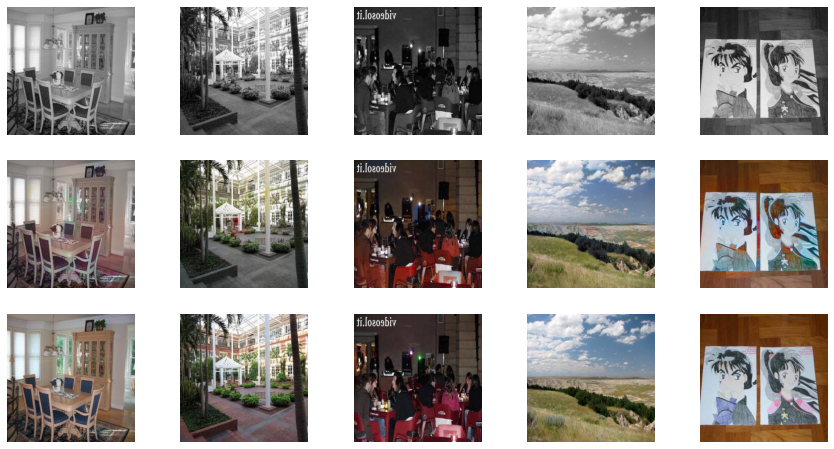

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 52/100
Iteration 215/219
loss_D_fake: 0.59890
loss_D_real: 0.60949
loss_D: 0.60419
loss_G_GAN: 1.01013
loss_G_L1: 5.79149
loss_G: 6.80162


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return func(*args, **kwargs)


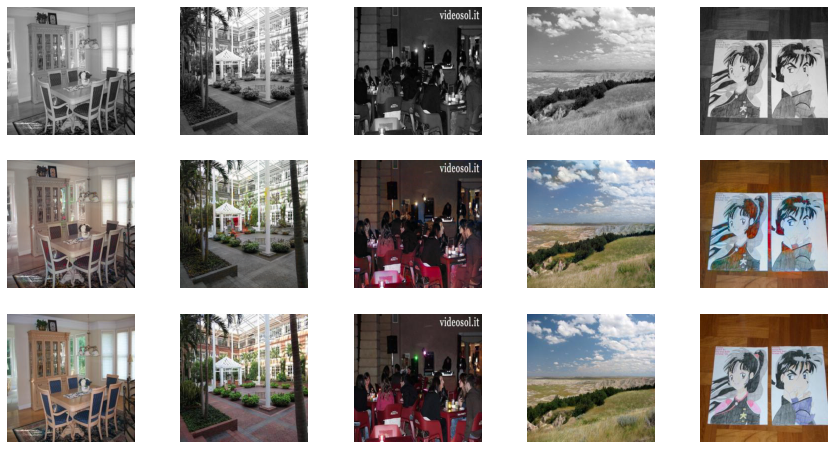

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 55/100
Iteration 215/219
loss_D_fake: 0.66517
loss_D_real: 0.66644
loss_D: 0.66581
loss_G_GAN: 1.07757
loss_G_L1: 5.66740
loss_G: 6.74497


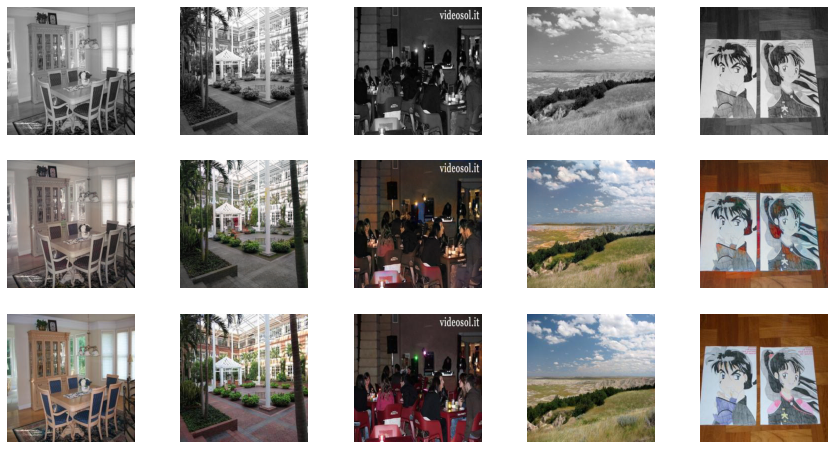

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 58/100
Iteration 215/219
loss_D_fake: 0.58877
loss_D_real: 0.59944
loss_D: 0.59411
loss_G_GAN: 1.00767
loss_G_L1: 5.58391
loss_G: 6.59158


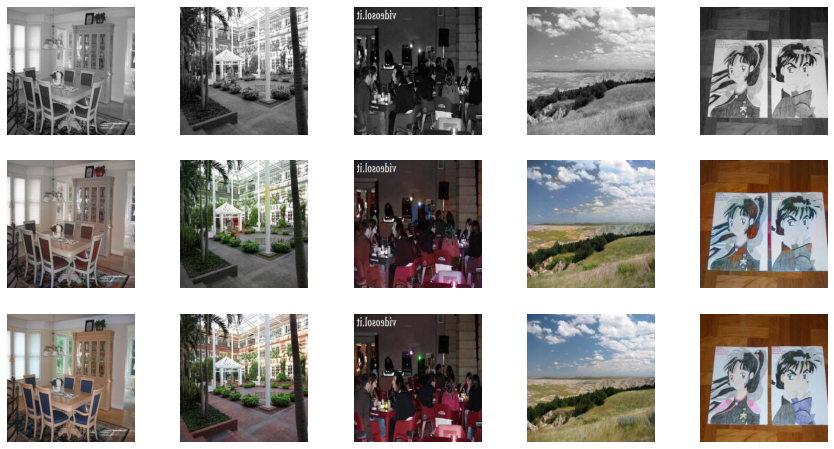

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 61/100
Iteration 215/219
loss_D_fake: 0.58625
loss_D_real: 0.59488
loss_D: 0.59056
loss_G_GAN: 1.05189
loss_G_L1: 5.43213
loss_G: 6.48402


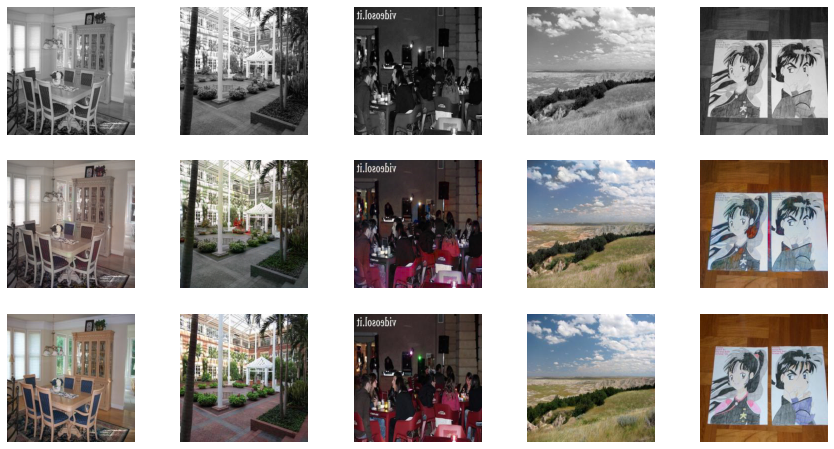

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 64/100
Iteration 215/219
loss_D_fake: 0.56601
loss_D_real: 0.57268
loss_D: 0.56934
loss_G_GAN: 1.04038
loss_G_L1: 5.34406
loss_G: 6.38444


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return func(*args, **kwargs)


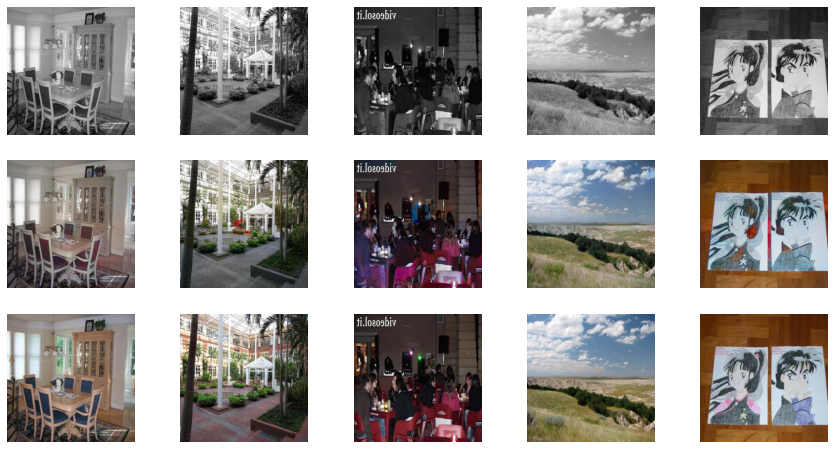

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 67/100
Iteration 215/219
loss_D_fake: 0.69393
loss_D_real: 0.68443
loss_D: 0.68918
loss_G_GAN: 1.11733
loss_G_L1: 5.22136
loss_G: 6.33869


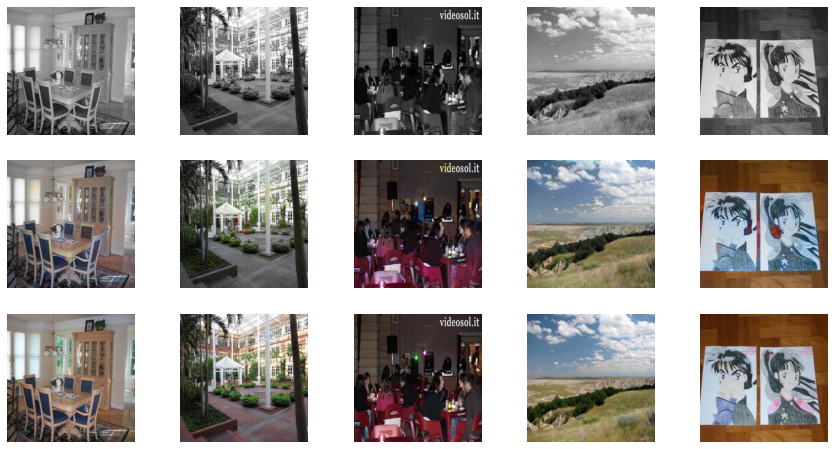

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 70/100
Iteration 215/219
loss_D_fake: 0.46134
loss_D_real: 0.45680
loss_D: 0.45907
loss_G_GAN: 1.75667
loss_G_L1: 5.34502
loss_G: 7.10170


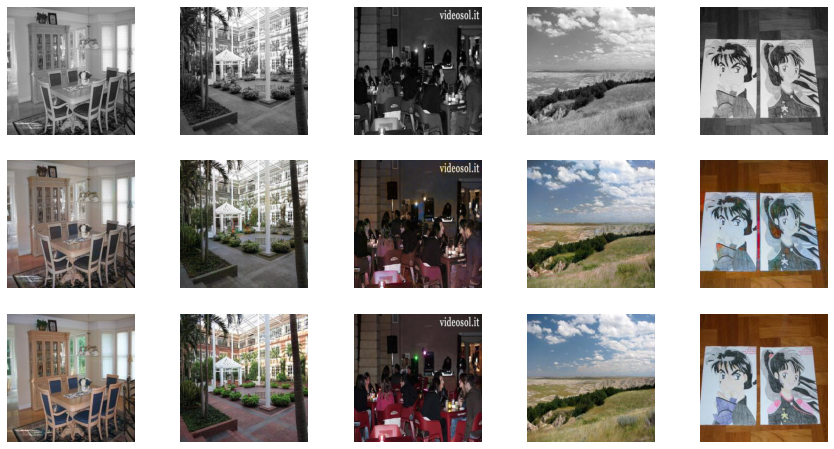

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 73/100
Iteration 215/219
loss_D_fake: 0.49075
loss_D_real: 0.49438
loss_D: 0.49257
loss_G_GAN: 1.37362
loss_G_L1: 5.09973
loss_G: 6.47336


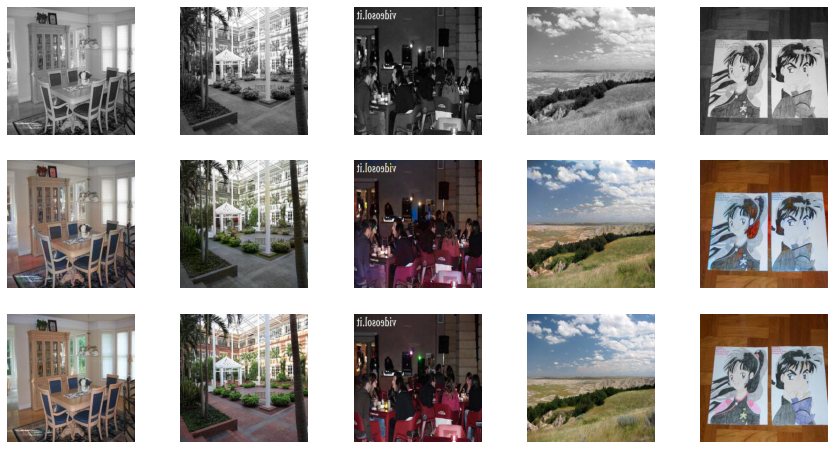

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 76/100
Iteration 215/219
loss_D_fake: 0.48897
loss_D_real: 0.49230
loss_D: 0.49063
loss_G_GAN: 1.23868
loss_G_L1: 5.01038
loss_G: 6.24906


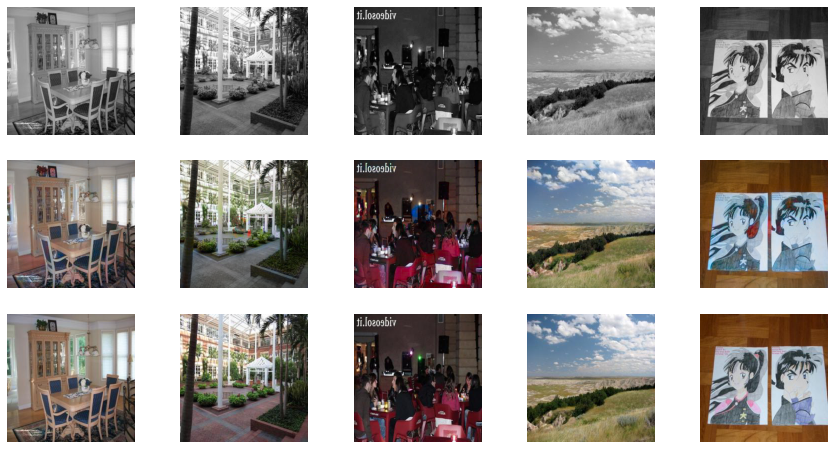

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 79/100
Iteration 215/219
loss_D_fake: 0.46620
loss_D_real: 0.46618
loss_D: 0.46619
loss_G_GAN: 1.41458
loss_G_L1: 4.98590
loss_G: 6.40048


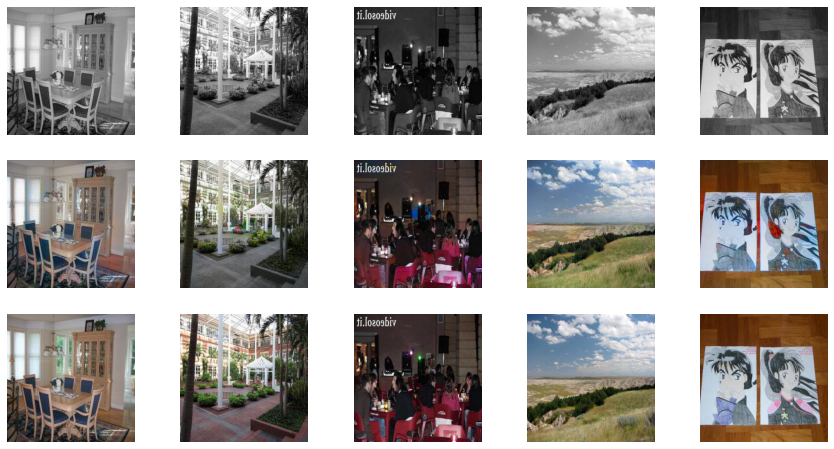

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 82/100
Iteration 215/219
loss_D_fake: 0.45506
loss_D_real: 0.45515
loss_D: 0.45511
loss_G_GAN: 1.58028
loss_G_L1: 4.94112
loss_G: 6.52140


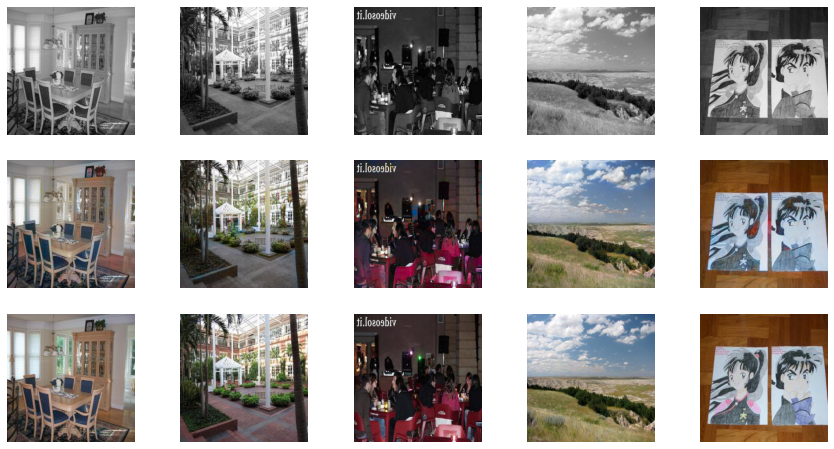

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 85/100
Iteration 215/219
loss_D_fake: 0.49611
loss_D_real: 0.50739
loss_D: 0.50175
loss_G_GAN: 1.56277
loss_G_L1: 4.85661
loss_G: 6.41938


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 81 pixels
  return func(*args, **kwargs)


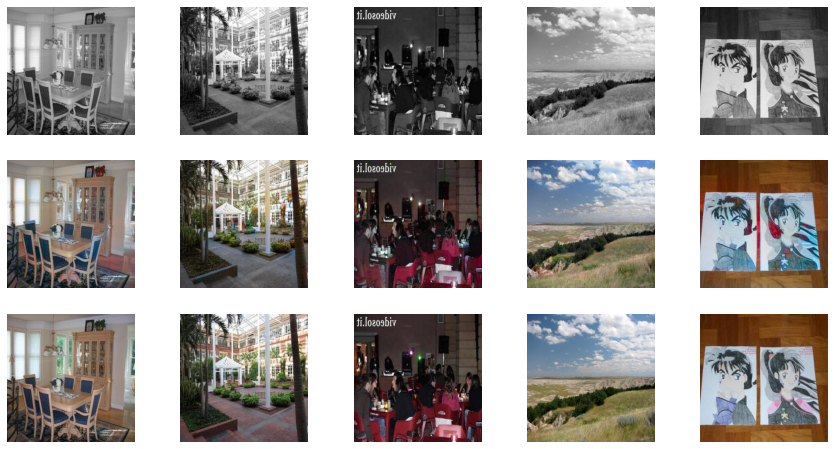

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 88/100
Iteration 215/219
loss_D_fake: 0.42077
loss_D_real: 0.41802
loss_D: 0.41939
loss_G_GAN: 1.59203
loss_G_L1: 4.81755
loss_G: 6.40958


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 76 pixels
  return func(*args, **kwargs)


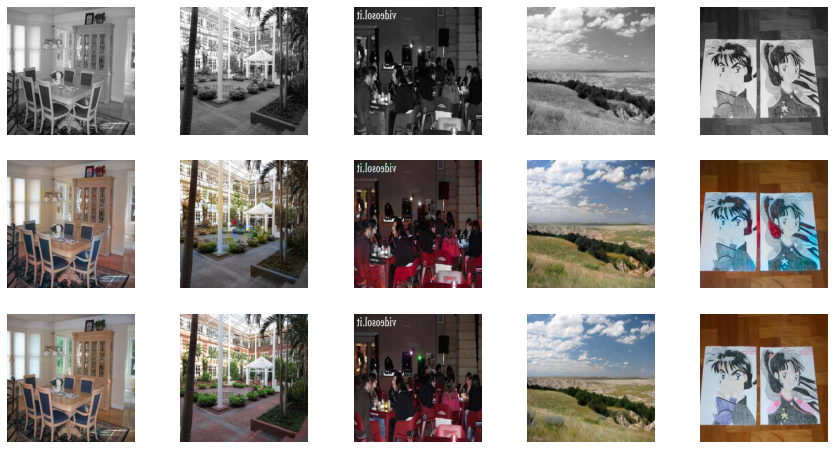

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 91/100
Iteration 215/219
loss_D_fake: 0.43837
loss_D_real: 0.43410
loss_D: 0.43623
loss_G_GAN: 1.77038
loss_G_L1: 4.78915
loss_G: 6.55953


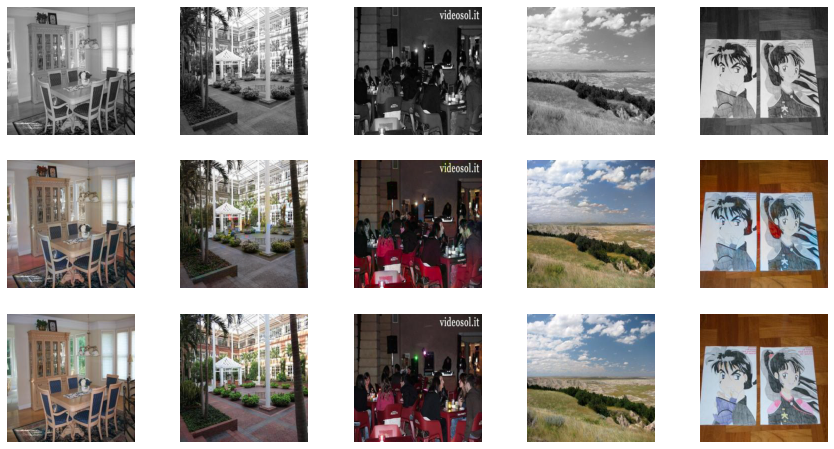

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 94/100
Iteration 215/219
loss_D_fake: 0.42842
loss_D_real: 0.42371
loss_D: 0.42607
loss_G_GAN: 1.73266
loss_G_L1: 4.74770
loss_G: 6.48035


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return func(*args, **kwargs)


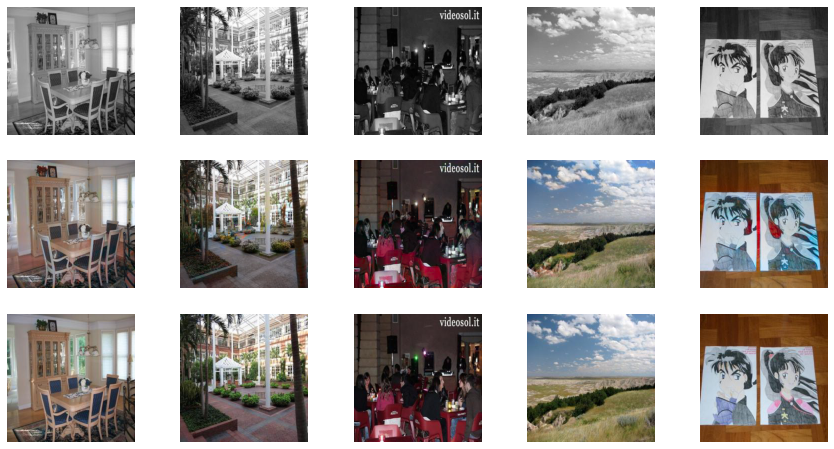

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 97/100
Iteration 215/219
loss_D_fake: 0.40712
loss_D_real: 0.40164
loss_D: 0.40438
loss_G_GAN: 1.80138
loss_G_L1: 4.70722
loss_G: 6.50860


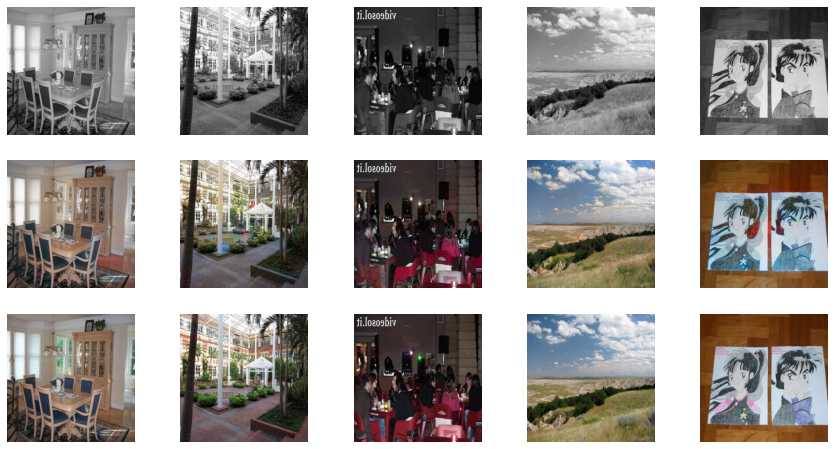

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]


Epoch 100/100
Iteration 215/219
loss_D_fake: 0.38791
loss_D_real: 0.38295
loss_D: 0.38543
loss_G_GAN: 1.79357
loss_G_L1: 4.66876
loss_G: 6.46233


/opt/conda/lib/python3.7/site-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 96 pixels
  return func(*args, **kwargs)


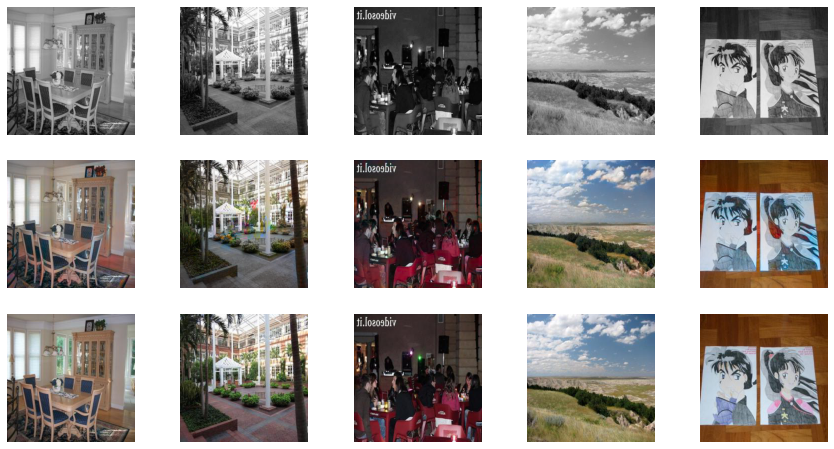

In [14]:
def train_model(model, train_dl, epochs, display_every=215):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if e % 3 == 0 and i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

train_model(model, train_dl, 100)
torch.save(model.state_dict(), "model2_100ep.pt")

# Inference: Coloring Images

In [8]:
# Loading Model
model = Model()
model.load_state_dict(torch.load('./model2_100ep.pt'))

<All keys matched successfully>

In [9]:
def color(model, img_path):
    # load image
    img = Image.open(img_path).convert("RGB")
    img = transforms.Resize((256, 256))(img)
    
    # converting image to L*a*b formate tensors
    img = np.array(img)
    img_lab = rgb2lab(img).astype("float32")
    img_lab = transforms.ToTensor()(img_lab)
    img_lab = img_lab.unsqueeze(1)
    
    # rescaling images to range from [-1, 1]
    L = img_lab[[0], ...] / 50. - 1. 
    ab = img_lab[[1, 2], ...] / 110.
    data = {'L':L, 'ab':ab}
    
    # running image through model
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    
    # reconstructing the image
    fake_color = model.fake_color.detach()
    L = model.L
    
    fake_img = lab_to_rgb(L, fake_color)
    gray_img = L[0].cpu().numpy().transpose(1,2,0)
    
    # showing image
    fig = plt.figure(figsize=(15, 15))
    plt.subplot(121)
    plt.imshow(gray_img, cmap='gray')
    plt.subplot(122)
    plt.imshow(fake_img[0])

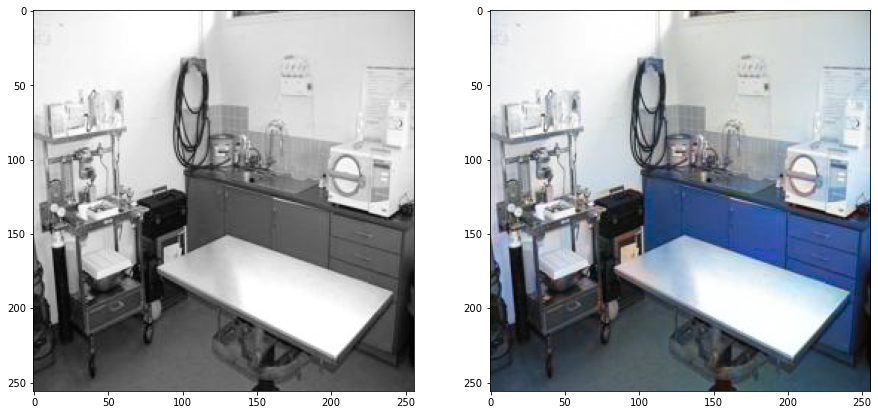

In [13]:
color(model, "./places365/samples/Places365_val_00000081.jpg")